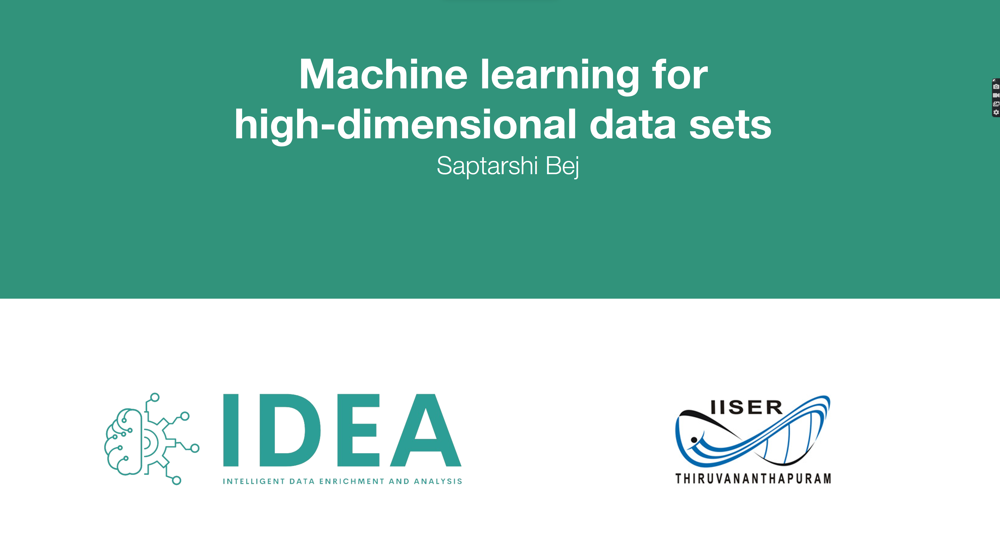

## <span style="color:teal">Outline of the tutorial </span>
<br>
<font size="3">
    
* Several aspects of tabular data and different data types
* Converting raw data to refined data which can again be used for Machine Learning
* A brief intuition behind the undelying philosopy of Machine Learning 
* Qantifying similarity/dissimilarity among data points and its inherent importance 
* Finding similar groups of patients from high dimensional patient data 
* Visualizing similar groups of patients in lower dimensions
* A unbiased (in context of diverse feature types in patient data) patient statification approach

## <span style="color:teal">The general structure of tabular data</span>

<font size="3">Stroke prediction dataset (Source: <a href="https://www.kaggle.com/datasets/fedesoriano/stroke-prediction-dataset" target="_blank">Kaggle</a>) 

<br>

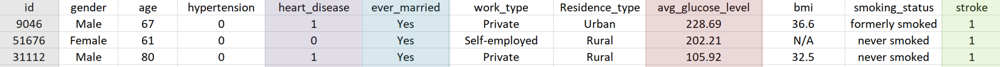

<br>
    
**Goal:** Predicting event of a <span style="color:green">stroke</span> *(target/ground truth)* depending on several *features* such as <span style="color:orange">gender, age…smoking status</span>

- There are both numerical (age) and non-numerical (work_type) 
    
- For a Machine Learning model non-numerical data has to be converted to numerical
    
- Even among numerical data there are two data types:
    * <span style="color:salmon">Continuous</span> (can obtain any real value in a range) e.g. <span style="color:salmon">avg_glucose_level</span> 
    * Categorical (obtains only discrete values) e.g. heart_disese, ever_married, work_type
    * Further, there are two types of categorical variables:
        - <span style="color:plum">Ordinal</span> Ordinal (has an intrinsic sense of order associated to it) e.g. <span style="color:plum">heart_disease</span>
        - <span style="color:lightblue">Nominal</span> (has no intrinsic sense of order associated to it) e.g. <span style="color:lightblue">ever_married</span>
- Not all values are available in real-life data – e.g. BMI for patient id: 51676  


## <span style="color:teal">Importing the data and first look</span>

### <span style="color:teal">Importing a python library</span>

In [1]:
%config InlineBackend.figure_format = 'svg'

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
import pandas as pd
import numpy as np

### <span style="color:teal">Importing and looking at the data</span>

Import the data in '.csv' or '.xlsx' or '.txt' format

In [4]:
filename='healthcare-dataset-stroke-data.csv'
data=pd.read_csv(filename,index_col=0)

In [5]:
np.random.seed(42)
data=data.sample(frac=1)

In [6]:
data=data[:500]

We take only the first 500 of the shuffled dataset for the purpose of smooth running of the tutorial

Look at the first 10 rows (data points) in the table

In [7]:
data.head(10)

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
id,,,,,,,,,,,
40041,Male,31.00,0,0,No,Self-employed,Rural,64.85,23.0,Unknown,0
55244,Male,40.00,0,0,Yes,Self-employed,Rural,65.29,28.3,never smoked,0
70992,Female,8.00,0,0,No,children,Urban,74.42,22.5,Unknown,0
38207,Female,79.00,1,0,Yes,Self-employed,Rural,76.64,19.5,never smoked,0
8541,Female,75.00,0,0,Yes,Govt_job,Rural,94.77,27.2,never smoked,0
2467,Female,79.00,1,0,Yes,Self-employed,Rural,92.43,NaN,never smoked,0
19828,Female,56.00,1,0,Yes,Private,Rural,97.37,34.1,smokes,0
621,Male,69.00,0,0,Yes,Private,Rural,101.52,26.8,smokes,0
54975,Male,7.00,0,0,No,Self-employed,Rural,64.06,18.9,Unknown,0


Look at the data dimensions

In [8]:
data.shape

(500, 11)

Look at column names in the data

In [9]:
data.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'ever_married',
       'work_type', 'Residence_type', 'avg_glucose_level', 'bmi',
       'smoking_status', 'stroke'],
      dtype='object')

Look at the distribution of unavailable values over data columns. We have to address the issue of unavailable data using a 'preprocessing' step discussed later

In [10]:
data.isna().sum()

gender                0
age                   0
hypertension          0
heart_disease         0
ever_married          0
work_type             0
Residence_type        0
avg_glucose_level     0
bmi                  23
smoking_status        0
stroke                0
dtype: int64

For working with ML algorithms we need only numberical data. This is why we check whether there is some non numerical data so that we can convert them to numerical data before using ML.

In [11]:
data.dtypes

gender                object
age                  float64
hypertension           int64
heart_disease          int64
ever_married          object
work_type             object
Residence_type        object
avg_glucose_level    float64
bmi                  float64
smoking_status        object
stroke                 int64
dtype: object

## <span style="color:teal">Pre-processing: The boring yet essential step</span>

<font size="3">
<br>
Approaches to make the crude real-world data suitable for machine learning:
<br>
    
- Handling values that are not available (removing too many can cause serious data loss)
- Feature selection (an umbrella term of several techniques with a crucial motivation)

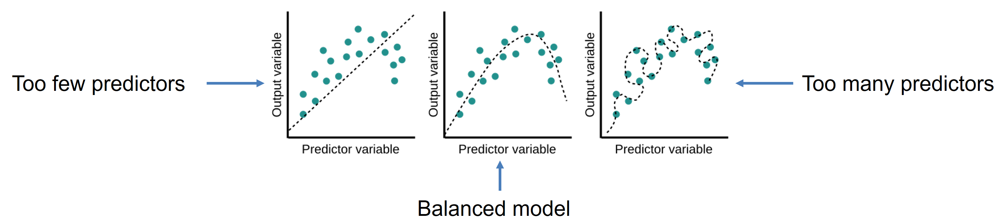

<br>
    
- Removing redundant features, e.g. if BMI is a feature, then there is no need to consider height and weight separately, since BMI is calculated using height and weight.
- Highly co-related features is also indicative of redundancy
    
   


### <span style="color:teal">Replacing categorical data with numerical values</span>

In [12]:
data['gender'].value_counts()

Female    293
Male      206
Other       1
Name: gender, dtype: int64

In [13]:
data['gender'][:10]

id
40041      Male
55244      Male
70992    Female
38207    Female
8541     Female
2467     Female
19828    Female
621        Male
54975      Male
57485    Female
Name: gender, dtype: object

In [14]:
cleanup_nums = {'gender': {"Female": 1, "Male": 0, "Other": -1}}
data.replace(cleanup_nums, inplace=True)

In [15]:
data['gender'][:10]

id
40041    0
55244    0
70992    1
38207    1
8541     1
2467     1
19828    1
621      0
54975    0
57485    1
Name: gender, dtype: int64

In [16]:
data['ever_married'].value_counts()

Yes    333
No     167
Name: ever_married, dtype: int64

In [17]:
cleanup_nums = {'ever_married': {"Yes": 1, "No": 0}}
data.replace(cleanup_nums, inplace=True)

In [18]:
data['work_type'].value_counts()

Private          296
Self-employed     81
children          68
Govt_job          55
Name: work_type, dtype: int64

In [19]:
cleanup_nums = {'work_type': {"Private": 0, "Self-employed": 1, 'children':2, 'Govt_job':3, 'Never_worked':-1}}
data.replace(cleanup_nums, inplace=True)

In [20]:
data['Residence_type'].value_counts()

Rural    256
Urban    244
Name: Residence_type, dtype: int64

In [21]:
cleanup_nums = {'Residence_type': {"Urban": 0, "Rural": 1}}
data.replace(cleanup_nums, inplace=True)

In [22]:
data['smoking_status'].value_counts()

never smoked       184
Unknown            139
smokes              93
formerly smoked     84
Name: smoking_status, dtype: int64

In [23]:
cleanup_nums = {'smoking_status': {"never smoked": 0, "Unknown": -1, 'formerly smoked': 1, 'smokes':2}}
data.replace(cleanup_nums, inplace=True)

It is a good practice to record the pre-processing non-numeric to numeric transformation in form of a dictionary. We can use this later during data vizualization.

In [24]:
rev_dict={'gender': {"Female": 1, "Male": 0, "Other": -1},'ever_married': {"Yes": 1, "No": 0},'work_type': {"Private": 0, "Self-employed": 1, 'children':2, 'Govt_job':3, 'Never_worked':-1},
         'Residence_type': {"Urban": 0, "Rural": 1},'smoking_status': {"never smoked": 0, "Unknown": -1, 'formerly smoked': 1, 'smokes':2}, 'hypertension':{"Yes": 1, "No": 0},
         'heart_disease': {"Yes": 1, "No": 0}, 'stroke':{"Yes": 1, "No": 0}}

Finally we can recheck whether there is any non-numeric feature left in the data:

In [25]:
data.dtypes

gender                 int64
age                  float64
hypertension           int64
heart_disease          int64
ever_married           int64
work_type              int64
Residence_type         int64
avg_glucose_level    float64
bmi                  float64
smoking_status         int64
stroke                 int64
dtype: object

### <span style="color:teal">Imputing missing values</span>

There are various techniques to impute missing values. For example choosing column mean or mode, or interpolate among the closest available data points. For time constraint we are not exploring the details in this tutorial.

In [26]:
dense_data_pool=list(data.isna().sum().index[data.isna().sum()<4])
dense_data=data[dense_data_pool]
dense_data=dense_data.dropna()
data=data.loc[np.array(dense_data.index)]

<div>
   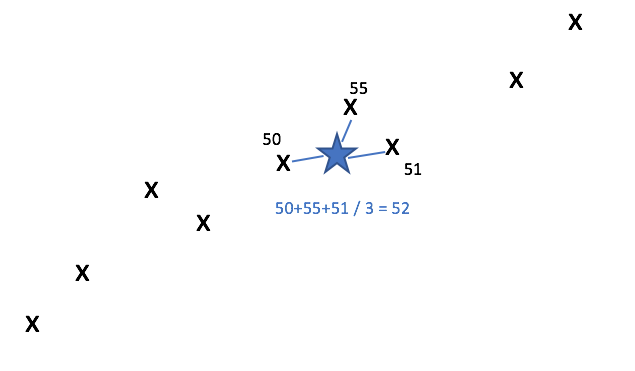
</div>

In [27]:
from scipy.spatial import distance
distance_matrix=[]
for i in range(len(np.array(dense_data))):
    dist=[]
    for j in range(len(np.array(dense_data))):
        d=distance.euclidean(np.array(dense_data)[i],np.array(dense_data)[j])
        dist.append(d)
        neb_list=np.array(dense_data.index)[np.argsort(dist)]
    distance_matrix.append(neb_list)
distance_matrix=np.array(distance_matrix)

In [28]:
missing_value_list = [x for x in list(data.columns) if x not in dense_data_pool]

In [29]:
total_impute_master=[]
for f in range(len(missing_value_list)):
    missing_value_indices=data[data[missing_value_list[f]].isnull()].index.tolist()
    feature_impute_master=[]
    for index in missing_value_indices:
        index_in_dist_mat=np.where(distance_matrix[:,0]==index)[0][0]
        value_list=[]
        neb_index_counter=1
        while len(value_list)<6:
            neb_index=distance_matrix[index_in_dist_mat][neb_index_counter]
            neb_index_counter=neb_index_counter+1
            impute_value=data.loc[[neb_index]][missing_value_list[f]]
            if float(impute_value)!=float(impute_value):
                pass
            else:
                value_list.append(float(impute_value))
        feature_impute_master.append(np.array(value_list))
    total_impute_master.append(np.array(feature_impute_master))
total_impute_mater=np.array(total_impute_master)


In [30]:
total_impute=[]
for i in range(len(total_impute_master)):
    feature_impute=[]
    for j in range(len(total_impute_master[i])):
        intcounter=0
        for k in range(len(total_impute_master[i][j])):
            if total_impute_master[i][j][k]-int(total_impute_master[i][j][k])==0:
                intcounter=intcounter+1
        if intcounter==len(total_impute_master[i][j]):
            imputed_value=np.bincount(total_impute_master[i][j].astype(int)).argmax()
        else:
            imputed_value=np.mean(total_impute_master[i][j])
        feature_impute.append(np.array(imputed_value))
    total_impute.append(np.array(feature_impute))
    

In [31]:
for f in range(len(missing_value_list)):
    missing_value_indices=data[data[missing_value_list[f]].isnull()].index.tolist()
    for i in range(len(missing_value_indices)):
        data.at[missing_value_indices[i], missing_value_list[f]]=total_impute[f][i]

We can finally recheck if there is any missing value left in the data

In [32]:
data.isna().sum()

gender               0
age                  0
hypertension         0
heart_disease        0
ever_married         0
work_type            0
Residence_type       0
avg_glucose_level    0
bmi                  0
smoking_status       0
stroke               0
dtype: int64

## <span style="color:teal">Information content in features</span>

<br>

<font size="3">
    
It is important to quantify the information content in features and to remove features with low information content

<br>
    
- Features with more variance have a high information content and should be retained during feature selection


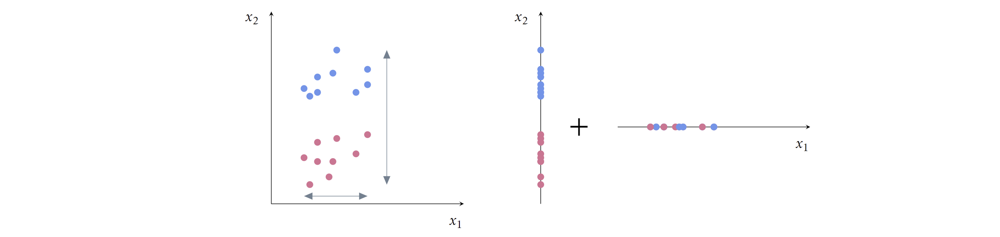

<br>
    
- Information content in categorical variables can also be measured by <a href="https://en.wikipedia.org/wiki/Entropy_(information_theory)">Shannon Entropy</a>, which quantifies the diversity of the information present in a feature
    
  



### <span style="color:teal">Quantifying information content of features</span>

We now calculate the information content of categorical and continuous features sparately. 

In [33]:
nom_features=['gender','ever_married','work_type','Residence_type']
ord_features=['hypertension','heart_disease','stroke','smoking_status']
cont_features=['age','avg_glucose_level', 'bmi']

For categorical features we used the Shannon entropy.

In [34]:
from scipy.stats import entropy
cat_feature_entropies=[]
for feature in nom_features+ord_features:
    x=entropy(data[feature].value_counts(), base=2)/(len(data[feature].value_counts().index)-1)
    cat_feature_entropies.append(x)
    print(feature+' '+str(x))
cat_feature_entropies=np.array(cat_feature_entropies)

gender 0.49840927538558183
ever_married 0.9189610585062931
work_type 0.5382958922815603
Residence_type 0.9995844639313985
hypertension 0.462623491762443
heart_disease 0.34312290713202037
stroke 0.31135737042928313
smoking_status 0.6426183335743486


For contineous data we first normalize tha data (each feature mean is transformed to zero and each feature variance is transformed to one). Then we calculate the range (absolute value of max-min) for every feature

In [35]:
cont_feature_spread=[]
for feature in cont_features:
    standardardized=(data[feature]-data[feature].mean())/data[feature].std()
    x=abs(standardardized.max()-standardardized.min())
    cont_feature_spread.append(x)
    print(feature+'  '+str(x))
cont_feature_spread=np.array(cont_feature_spread)

age  3.661163007128385
avg_glucose_level  4.7189204035826195
bmi  7.815372101445886


Finally we recheck the preprocessed data

In [36]:
data.head(10)

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
id,,,,,,,,,,,
40041,0,31.00,0,0,0,1,1,64.85,23.000000,-1,0
55244,0,40.00,0,0,1,1,1,65.29,28.300000,0,0
70992,1,8.00,0,0,0,2,0,74.42,22.500000,-1,0
38207,1,79.00,1,0,1,1,1,76.64,19.500000,0,0
8541,1,75.00,0,0,1,3,1,94.77,27.200000,0,0
2467,1,79.00,1,0,1,1,1,92.43,28.083333,0,0
19828,1,56.00,1,0,1,0,1,97.37,34.100000,2,0
621,0,69.00,0,0,1,0,1,101.52,26.800000,2,0
54975,0,7.00,0,0,0,1,1,64.06,18.900000,-1,0


In [37]:
data.shape

(500, 11)

## <span style="color:teal">ML in a nutshell</span>

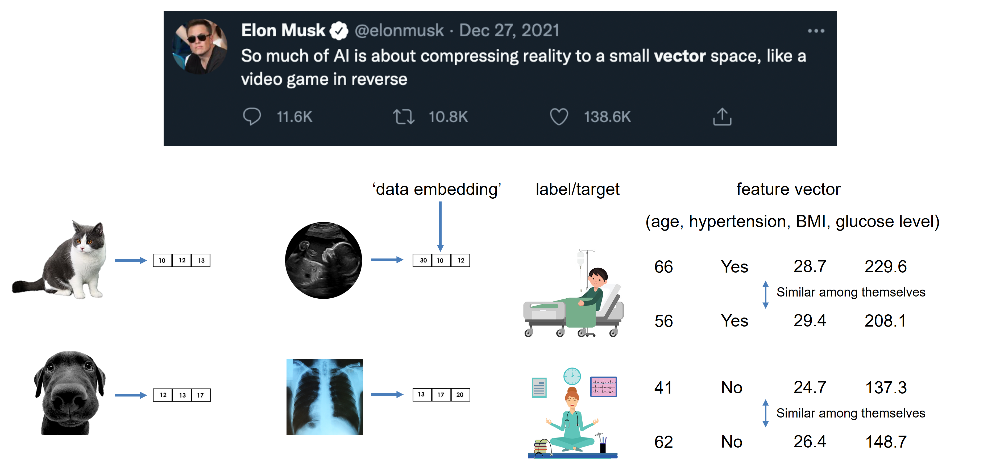

## <span style="color:teal">Similarity measures</span>

<br>

<font size="3">
Numerous similarity measures exist and are useful in various situations 
    
<br>

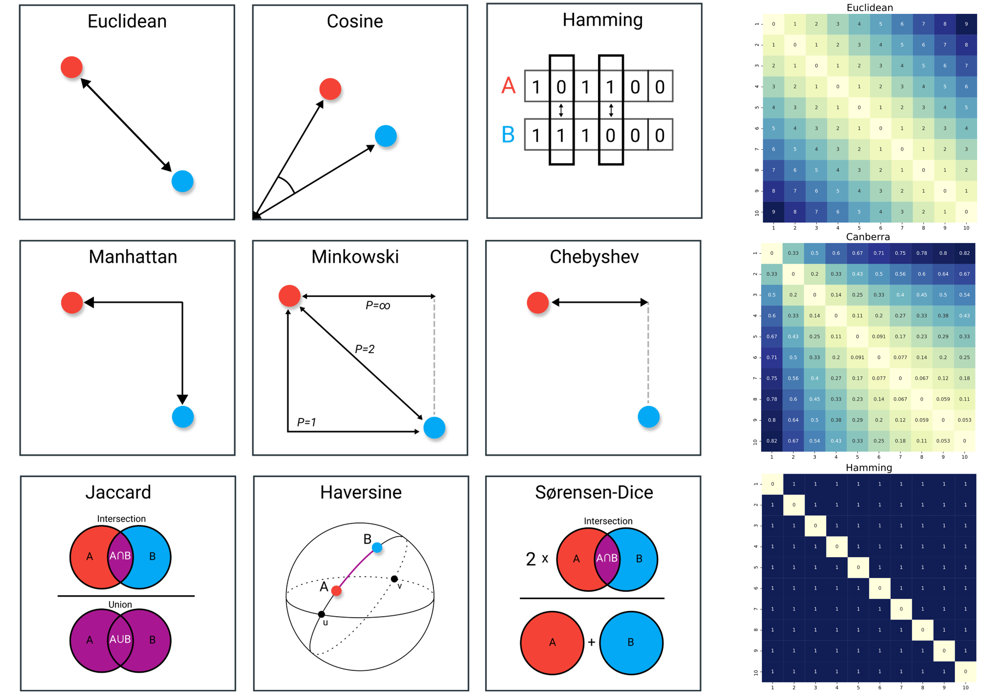



## <span style="color:teal">Clustering algorithms</span>

<br>

<font size="3">

- The goal of clustering is to find mutually similar (based on some similarity measure) groups in the data
-Each algorithm assigns a cluster to every data point
    
<br>

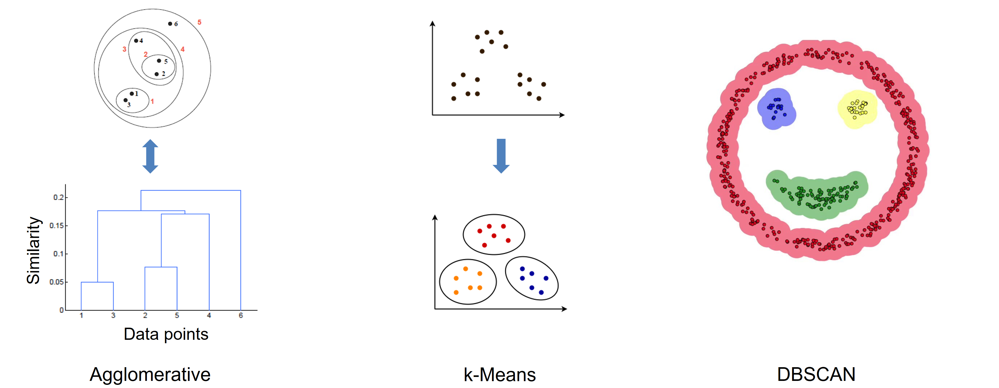



##### Understanding k-means

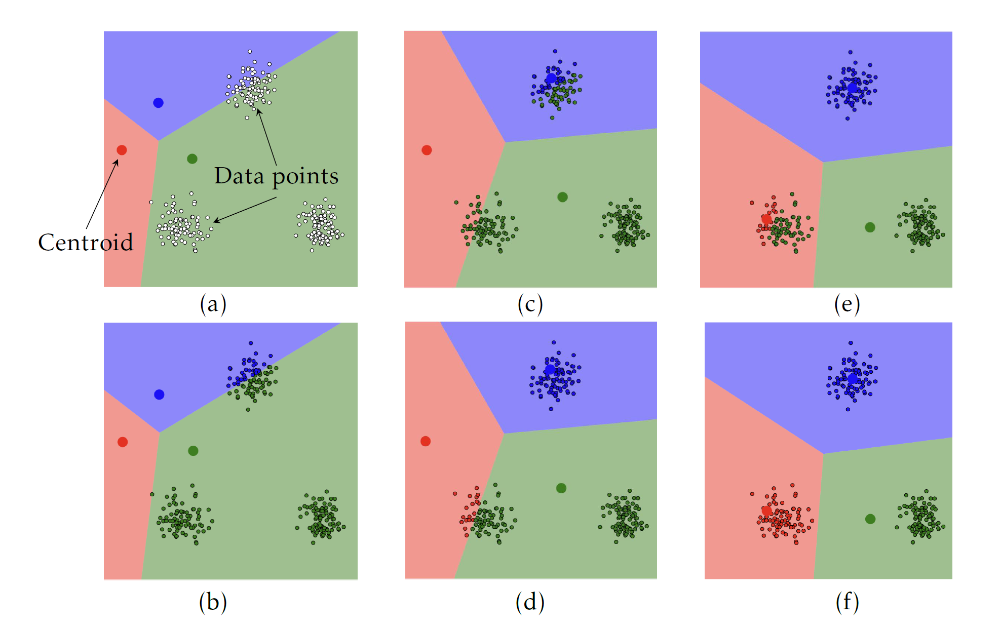

##### Understanding agglomerative clustering

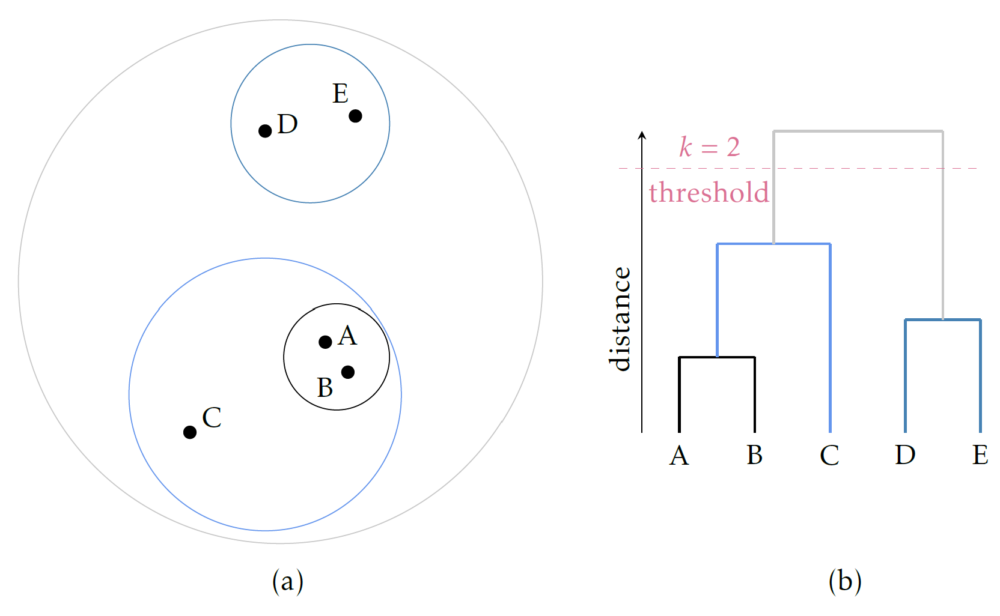

##### Understanding DBSCAN

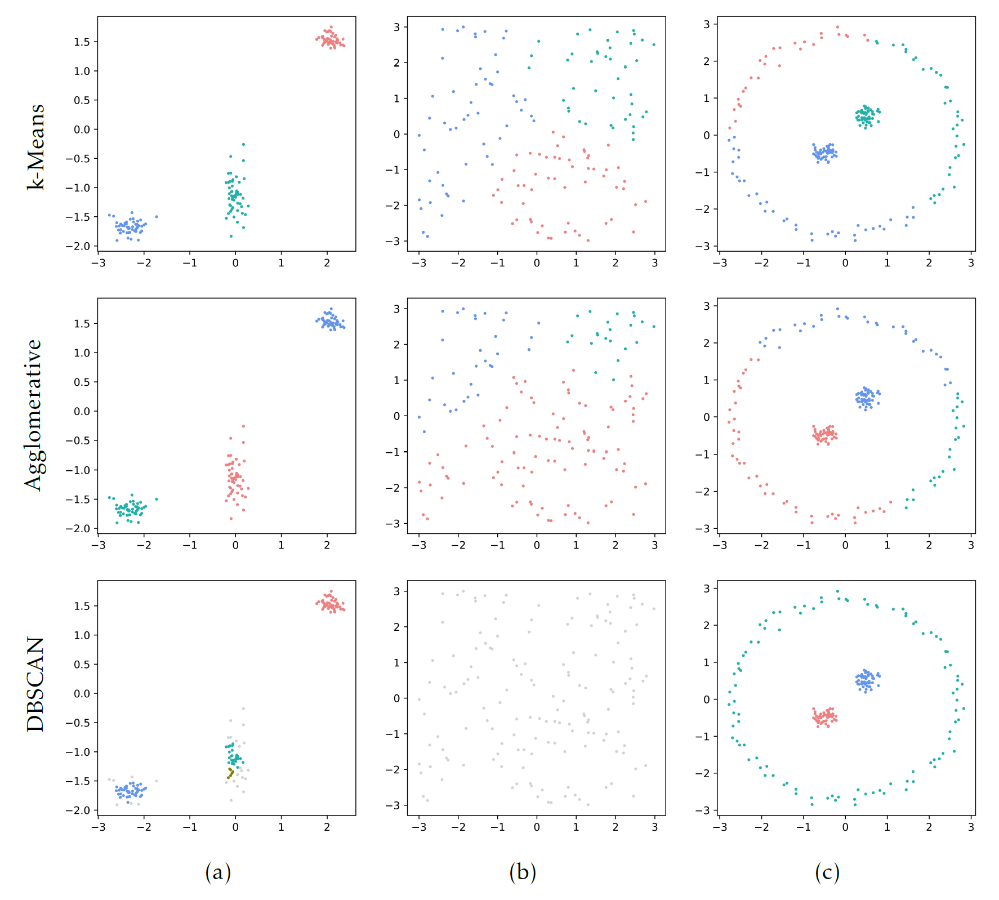

### <span style="color:teal">Finding clusters in the data</span>

#### DBSCAN Clustering

parameter settings eps=1.5 min_samples=20

There are four steps of using a ML model in Scikit-learn
- Import the model from the library
- Specify model parameters (the decision making of the model depend on the choice of parameters)
- Fit the data with the model
- Use the fitted model for prediction

In [38]:
from sklearn.cluster import DBSCAN

In [39]:
dbscan = DBSCAN(eps=1.5, min_samples = 20)

In [40]:
clusters_dbscan=dbscan.fit_predict((data-data.mean())/data.std())

In [41]:
(values_dbscan,counts_dbscan) = np.unique(clusters_dbscan,return_counts=True)

Now we look at the distribution of clusters obtained by DBSCAN under the specific parameter settings

In [42]:
for i in range(len(values_dbscan)):
    print('Cluster '+str(values_dbscan[i]+1)+' counts: '+str(counts_dbscan[i]))

Cluster 0 counts: 329
Cluster 1 counts: 34
Cluster 2 counts: 53
Cluster 3 counts: 37
Cluster 4 counts: 47


Note that if we change the parameter settings the model prediction changes

parameter settings eps=2 min_samples=10

In [43]:
dbscan = DBSCAN(eps=2, min_samples = 10)
clusters_dbscan=dbscan.fit_predict((data-data.mean())/data.std())
(values_dbscan,counts_dbscan) = np.unique(clusters_dbscan,return_counts=True)
for i in range(len(values_dbscan)):
    print('Cluster '+str(values_dbscan[i]+1)+' counts: '+str(counts_dbscan[i]))

Cluster 0 counts: 133
Cluster 1 counts: 23
Cluster 2 counts: 85
Cluster 3 counts: 94
Cluster 4 counts: 67
Cluster 5 counts: 33
Cluster 6 counts: 65


#### Agglomerative Clustering

parameter settings n_clusters=5,affinity="euclidean",linkage="ward"

In [44]:
from sklearn.cluster import AgglomerativeClustering
agg = AgglomerativeClustering(n_clusters=5,affinity="euclidean",linkage="ward")
clusters_agg=agg.fit_predict((data-data.mean())/data.std())
(values_agg,counts_agg) = np.unique(clusters_agg,return_counts=True)
for i in range(len(values_agg)):
    print('Cluster '+str(values_agg[i]+1)+' counts: '+str(counts_agg[i]))

Cluster 1 counts: 256
Cluster 2 counts: 153
Cluster 3 counts: 28
Cluster 4 counts: 26
Cluster 5 counts: 37


## <span style="color:teal">Diversity in Clustering algorithms</span>
 
    
<br>

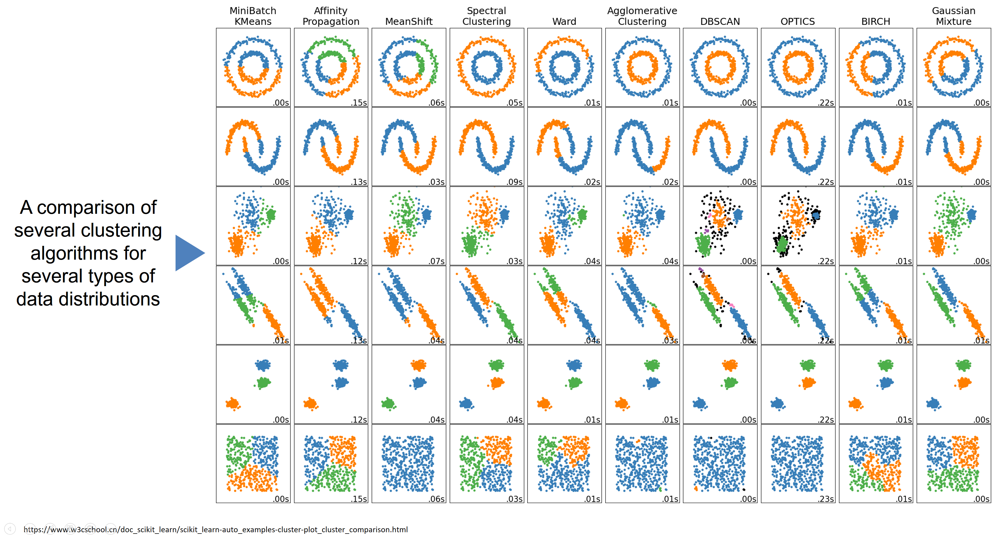



## <span style="color:teal">Vizualizing high dimensional data using Dimension reduction</span>
 
    
<br>

<font size="3">

- The strategy is to build projection of a high dimensional data into lower dimensions maintaining the information content in terms of similarity among data points as intact as possible
- Recall that, the more spread in a data along some direction, the more information content: Hence PCA
    
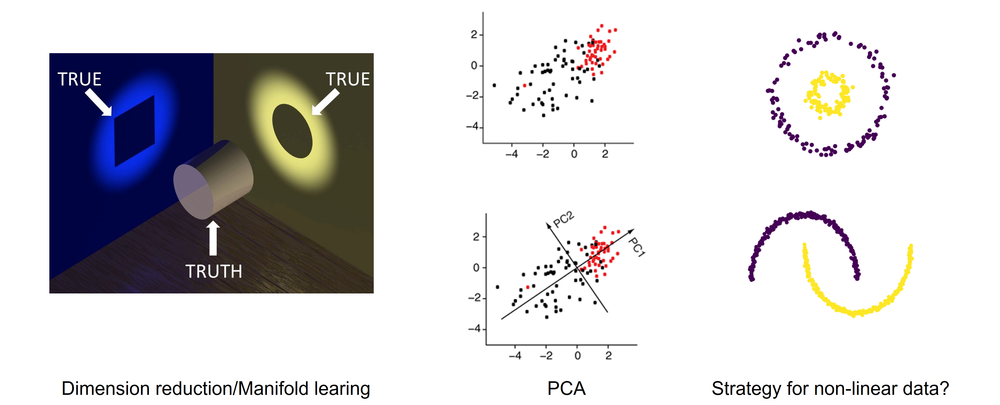
    


##### Understanding Principal Component Analysis (PCA)

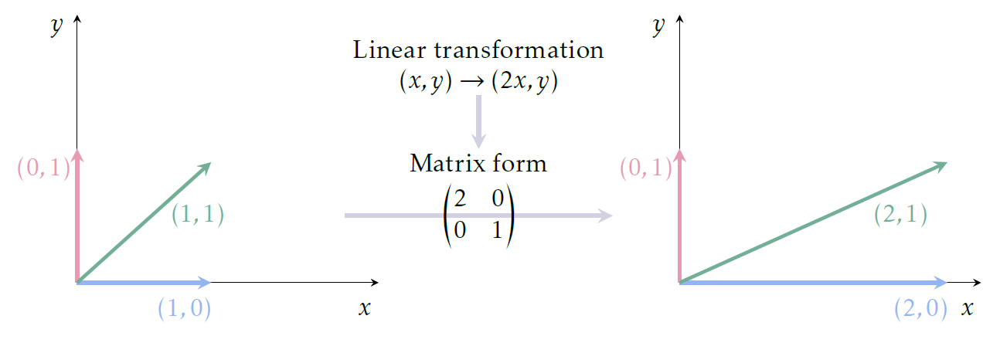

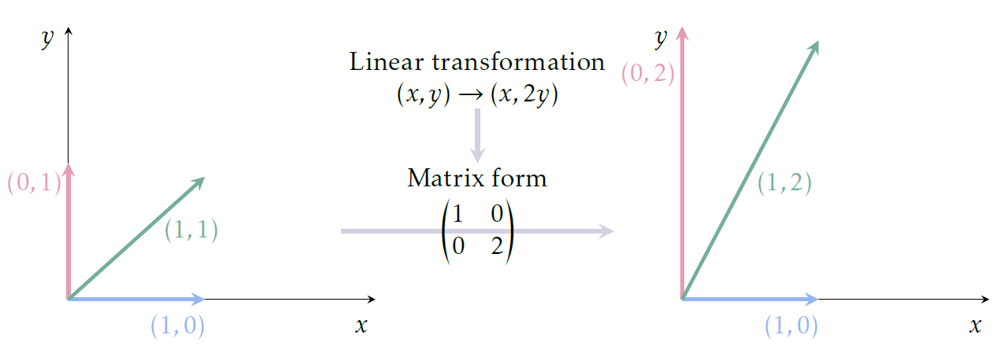

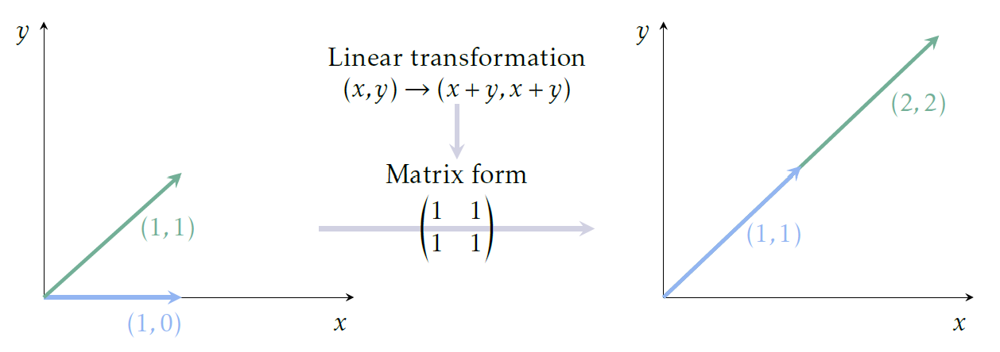

Solve the equation:
$$CX=\lambda X$$
- $X$ is the data matrix ($n\times f$)
- $C$ is the covariance matrix ($f\times f$)
- $C_{ij}$ is covariance between feature $i$ and feature $j$
- $C=XX^T$ for centered data $X$ 


- Solving the equation gives $f$ eigenvectors with respective eigenvalues
- The eigenvectors are orthogonal and the eigenvalues are real in this case
- The first $k$ eigenvectors can be used to transform the data into a $n\times k$ dimensional space

In [45]:
from sklearn.decomposition import PCA

In [46]:
pca = PCA(n_components=2)

In [47]:
low_dim_PCA=pca.fit_transform((data-data.mean())/data.std())

In [48]:
result_PCA = pd.DataFrame(data = low_dim_PCA , 
        columns = ['PCA_1', 'PCA_2'])

In [49]:
result_PCA['DBSCAN_clusters']=clusters_dbscan+1
result_PCA['Agglomerative_clusters']=clusters_agg+1
result_PCA['stroke']=np.array(data['stroke'])

In [50]:
result_PCA.head(10)

,PCA_1,PCA_2,DBSCAN_clusters,Agglomerative_clusters,stroke
0,-1.967599,0.224082,1,2,0
1,-0.184169,-0.562288,2,1,0
2,-2.879908,0.704221,3,2,0
3,0.916206,-0.483744,0,5,0
4,0.053280,-0.214408,4,1,0
5,1.418248,-0.577006,0,5,0
6,2.038984,-1.518028,0,5,0
7,1.444600,-1.048502,2,1,0
8,-2.727780,0.335220,1,2,0
9,-3.343449,0.073061,3,2,0


In [51]:
import seaborn as sns
from matplotlib import pyplot as plt

##### Vizualiting clusters obtained by DBSCAN on the PCA embeddings

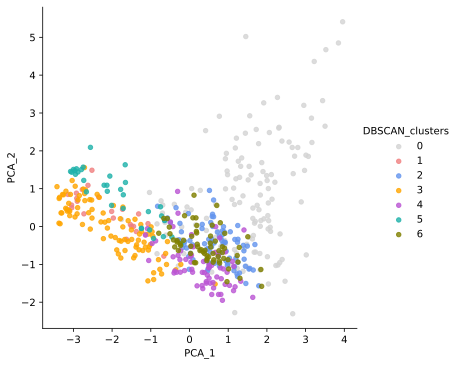

In [52]:
colors_set = ['lightgray','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="PCA_1", y="PCA_2",
  data=result_PCA, 
  fit_reg=False, 
  legend=True,
  hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

##### Vizualiting clusters obtained by Agglomerative clustering on the PCA embeddings

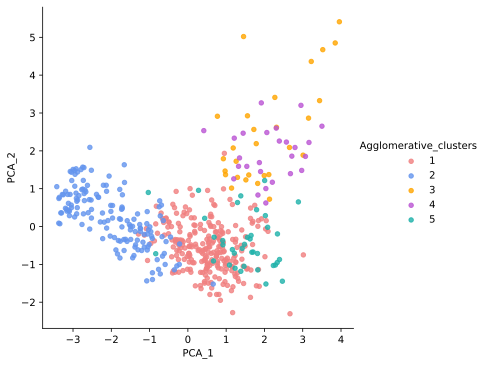

In [53]:
colors_set = ['lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="PCA_1", y="PCA_2",
  data=result_PCA, 
  fit_reg=False, 
  legend=True,
  hue='Agglomerative_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

##### Vizualiting distribution of target variable on PCA embedding

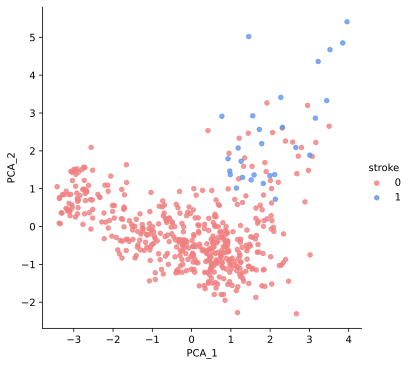

In [54]:
colors_set = ['lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="PCA_1", y="PCA_2",
  data=result_PCA, 
  fit_reg=False, 
  legend=True,
  hue='stroke', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

## <span style="color:teal">Non-linear dimension reduction strategies through Manifold learning</span>

<br>

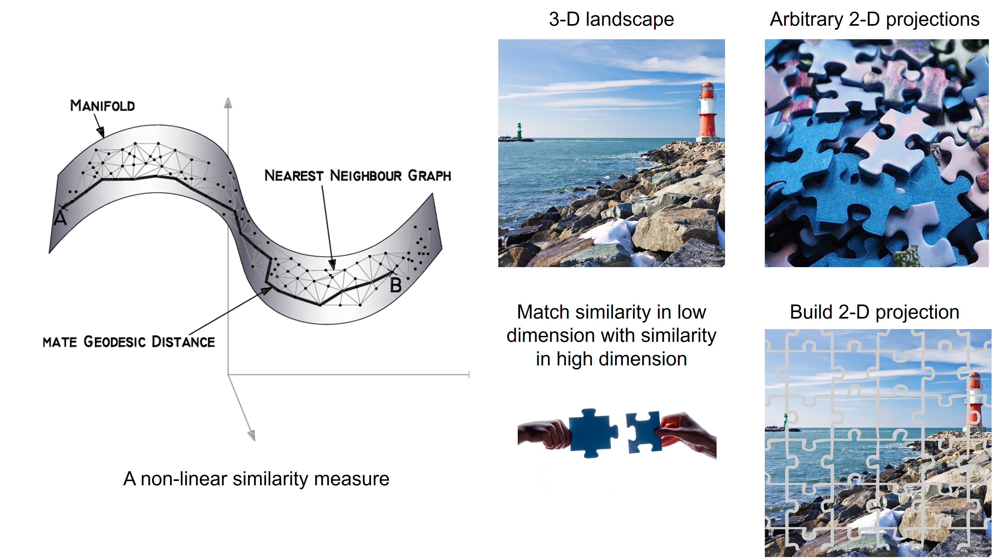

#### Uniform Manifold Approximation and Projection (UMAP)

In [55]:
import umap.umap_ as umap

In [56]:
low_dim_UMAP=umap.UMAP(n_neighbors=5, min_dist=0.1, n_components=2, random_state=42).fit_transform((data-data.mean())/data.std())

In [57]:
result_UMAP = pd.DataFrame(data = low_dim_UMAP , 
        columns = ['UMAP_1', 'UMAP_2'])

In [58]:
result_UMAP['DBSCAN_clusters']=clusters_dbscan+1
result_UMAP['Agglomerative_clusters']=clusters_agg+1
result_UMAP['stroke']=np.array(data['stroke'])

In [59]:
result_UMAP.head(10)

,UMAP_1,UMAP_2,DBSCAN_clusters,Agglomerative_clusters,stroke
0,5.519748,-5.826973,1,2,0
1,1.427263,0.973476,2,1,0
2,8.652699,20.094280,3,2,0
3,4.659931,6.249671,0,5,0
4,8.634429,7.079722,4,1,0
5,4.700643,6.334065,0,5,0
6,4.948054,6.933398,0,5,0
7,0.537559,1.505081,2,1,0
8,5.408675,-5.938777,1,2,0
9,15.788118,-8.667289,3,2,0


##### Vizualiting clusters obtained by DBSCAN on the UMAP embeddings

In [1]:
colors_set = ['lightgray','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

NameError: name 'sns' is not defined

##### Vizualiting clusters obtained by Agglomerative clusters on the UMAP embeddings

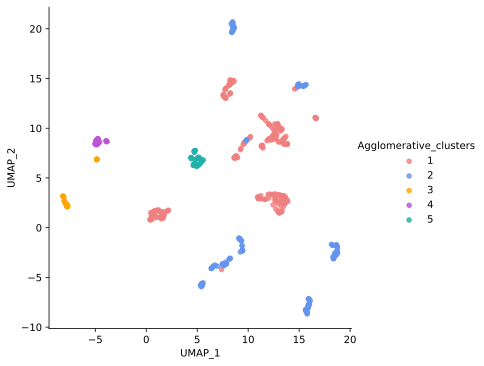

In [61]:
colors_set = ['lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  hue='Agglomerative_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

##### Vizualiting distribution of target variable on UMAP embedding

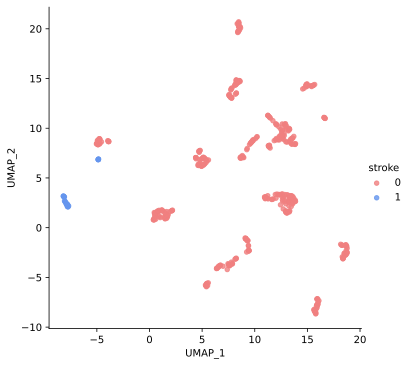

In [62]:
colors_set = ['lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  hue='stroke', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

##### Vizualiting distribution of smoking status on UMAP embedding

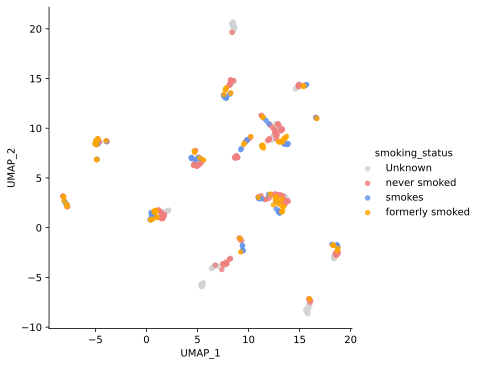

In [63]:
smoking_status_dict=rev_dict['smoking_status']
smoking_status_dict=dict((v,k) for k,v in smoking_status_dict.items())

smoking_status_labels=[]
for i in range(len(data['smoking_status'])):
    smoking_status_labels.append(smoking_status_dict[np.array(data['smoking_status'])[i]])
    
colors_set = ['lightgrey','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))
result_UMAP['smoking_status']=np.array(smoking_status_labels)

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  hue='smoking_status', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()
    

##### Vizualiting distribution of residence type on UMAP embedding

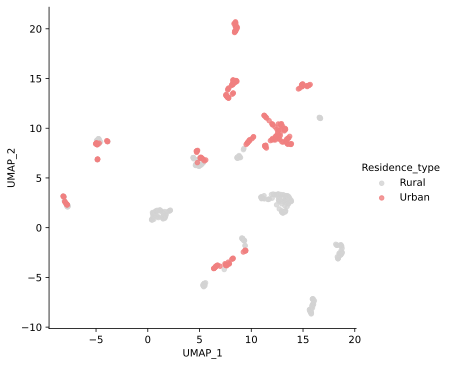

In [64]:
Residence_type_dict=rev_dict['Residence_type']
Residence_type_dict=dict((v,k) for k,v in Residence_type_dict.items())

Residence_type_labels=[]
for i in range(len(data['Residence_type'])):
    Residence_type_labels.append(Residence_type_dict[np.array(data['Residence_type'])[i]])
    
colors_set = ['lightgrey','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))
result_UMAP['Residence_type']=np.array(Residence_type_labels)

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  hue='Residence_type', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

## <span style="color:teal">How things look on a big data?</span>


In [65]:
df = pd.read_csv(r'Preprocessed_DM_xx.csv')
df=df.set_index('Unnamed: 0')
df_diabetes=df[df['DM_status']==1]

In [66]:
df_diabetes

,Current.age,Sex,Currently.has.asthma,Currently.has.thyroid.disorder,Currently.has.heart.disease,Currently.has.cancer,Suffers.from.TB,SBP_status,First.SYSTOLIC.reading,First.DIASTOLIC.reading,...,Has.motorcycle.scooter,Has.car.truck,Type.of.cooking.fuel,Household.structure,Owns.livestock..herds.or.farm.animals,Source.of.drinking.water,Time.to.get.to.water.source..minutes.,Glucose.level,DM_status,DM_history
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
4,41,1,0.0,0.0,0.0,0.0,0,0,117.0,82.0,...,0,0,4,0,0,3,0,128.0,1,1.0
53,38,1,0.0,0.0,0.0,0.0,0,1,138.0,90.0,...,1,0,3,0,1,3,0,140.0,1,1.0
59,47,1,0.0,0.0,0.0,0.0,0,0,124.0,90.0,...,1,1,3,0,0,3,0,277.0,1,1.0
81,49,1,0.0,0.0,0.0,0.0,0,1,138.0,88.0,...,1,1,3,0,0,3,0,106.0,1,1.0
120,26,1,0.0,0.0,0.0,0.0,0,0,112.0,69.0,...,1,1,1,0,0,3,0,136.0,1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
810462,39,1,0.0,0.0,0.0,0.0,0,0,121.0,92.0,...,1,0,3,0,0,3,0,431.0,1,1.0
810568,50,0,0.0,0.0,0.0,0.0,0,0,117.0,91.0,...,1,1,1,0,0,3,0,131.0,1,1.0
810673,46,1,0.0,0.0,0.0,0.0,0,1,141.0,83.0,...,1,0,3,0,0,3,0,176.0,1,1.0


##### Doing a PCA

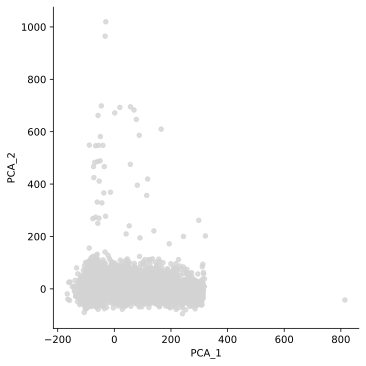

In [67]:
pca=PCA(n_components=2)
low_dim_PCA=pca.fit_transform(df_diabetes)
result_PCA = pd.DataFrame(data = low_dim_PCA , 
        columns = ['PCA_1', 'PCA_2'])
result_PCA.head(10)

colors_set = ['lightgray','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="PCA_1", y="PCA_2",
  data=result_PCA, 
  fit_reg=False, 
  legend=True,
  #hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

##### Doing an UMAP

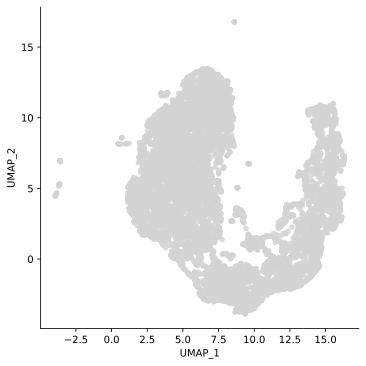

In [68]:
low_dim_UMAP=umap.UMAP(n_neighbors=5, min_dist=0.1, n_components=2, random_state=42).fit_transform(df_diabetes)
result_UMAP = pd.DataFrame(data = low_dim_UMAP , 
        columns = ['UMAP_1', 'UMAP_2'])
colors_set = ['lightgray','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="UMAP_1", y="UMAP_2",
  data=result_UMAP, 
  fit_reg=False, 
  legend=True,
  #hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20},palette=customPalette_set) # specify the point size
plt.show()

## <span style="color:teal">Feature-type Distributed Clustering (FDC)</span>
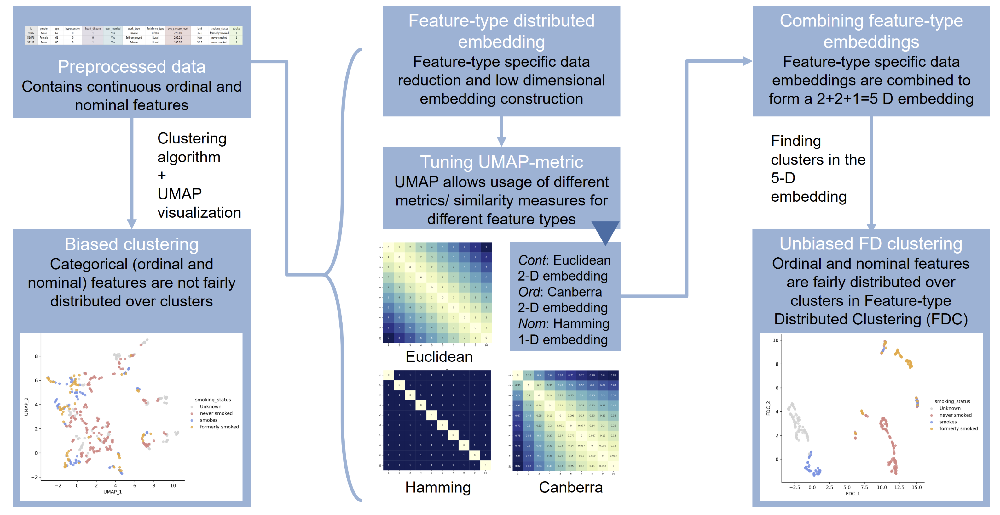

Bej, S., Sarkar, J., Biswas, S. et al. Identification and epidemiological characterization of Type-2 diabetes sub-population using an unsupervised machine learning approach. Nutr. Diabetes 12, 27 (2022). https://doi.org/10.1038/s41387-022-00206-2

In [69]:
array=np.arange(11)-5

distance_euc=[]
for i in range(len(array)):
    d=[]
    for j in range(len(array)):
        x=distance.euclidean(array[i],array[j])
        d.append(x)
    distance_euc.append(d)
distance_euc=np.array(distance_euc)/np.max(distance_euc)
#distance_euc=np.divide(distance_euc.T,np.max(distance_euc,axis=1)).T

distance_can=[]
for i in range(len(array)):
    d=[]
    for j in range(len(array)):
        x=distance.canberra(array[i],array[j])
        d.append(x)
    distance_can.append(d)
distance_can=np.array(distance_can)/np.max(distance_can)
#distance_can=np.divide(distance_can.T,np.max(distance_can,axis=1)).T

distance_canx=[]
for i in range(len(array)):
    d=[]
    for j in range(len(array)):
        x=distance.canberra(1,np.abs(array[i]-array[j])+1)
        d.append(np.sqrt(x))
    distance_canx.append(d)
distance_canx=np.array(distance_canx)/np.max(distance_canx)

distance_ham=[]
for i in range(len(array)):
    d=[]
    for j in range(len(array)):
        x=distance.hamming(array[i],array[j])
        d.append(x)
    distance_ham.append(d)
distance_ham=np.array(distance_ham)/np.max(distance_ham)
#distance_ham=np.divide(distance_ham.T,np.max(distance_ham,axis=1)).T

In [70]:
cont_features=['Current.age','BMI','Hemoglobin.level..g.dl...1.decimal.','Time.to.get.to.water.source..minutes.']
ord_features=['Currently.has.asthma',
       'Currently.has.thyroid.disorder', 'Currently.has.heart.disease',
       'Currently.has.cancer', 'Suffers.from.TB','Drinks.alcohol', 'Smoking_stat','Has.refrigerator',
       'Has.bicycle', 'Has.motorcycle.scooter', 'Has.car.truck', 'Owns.livestock..herds.or.farm.animals','Frequency.takes.milk.or.curd',
       'Frequency.eats.pulses.or.beans',
       'Frequency.eats.dark.green.leafy.vegetable', 'Frequency.eats.fruits',
       'Frequency.eats.eggs', 'Frequency.eats.fish',
       'Frequency.eats.chicken.or.meat', 'Frequency.eats.fried.food',
       'Frequency.takes.aerated.drinks','Frequency.household.members.smoke.inside.the.house','Wealth.index',
       'Highest.educational.level' ]
nom_features=['Household.head.s.religion', 'Sex', 'Type.of.place.of.residence', 'Household.structure',
       'Type.of.caste.or.tribe.of.the.household.head','Type.of.cooking.fuel','Source.of.drinking.water']

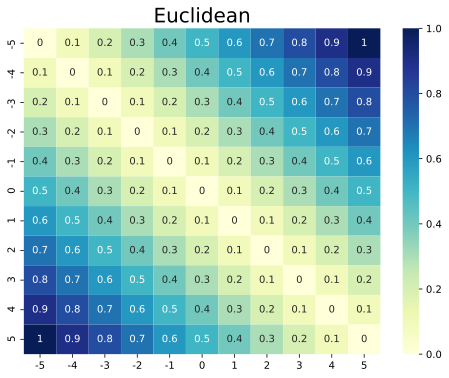

In [71]:
plt.subplots(figsize=(8, 6), dpi=600)
ax1 = sns.heatmap(distance_euc, cmap="YlGnBu", annot=True)
ax1.set_xticklabels(array)
ax1.set_yticklabels(array)
plt.title('Euclidean', fontsize=20)
plt.show()

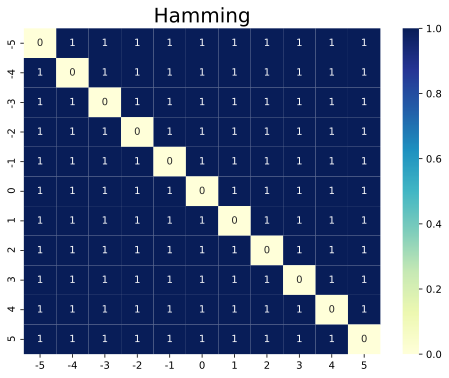

In [72]:
plt.subplots(figsize=(8, 6), dpi=600)
ax1 = sns.heatmap(distance_ham, cmap="YlGnBu", annot=True)
ax1.set_xticklabels(array)
ax1.set_yticklabels(array)
plt.title('Hamming',fontsize=20)
plt.show()

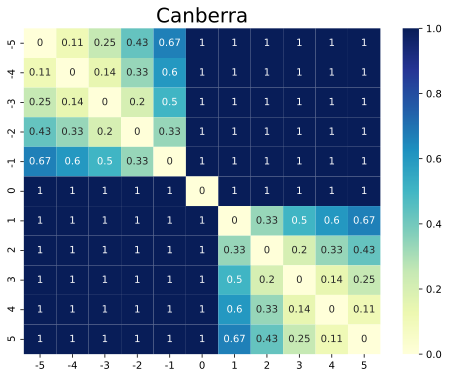

In [73]:
plt.subplots(figsize=(8, 6), dpi=600)
ax1 = sns.heatmap(distance_can, cmap="YlGnBu", annot=True)
ax1.set_xticklabels(array)
ax1.set_yticklabels(array)
plt.title('Canberra',fontsize=20)
plt.show()

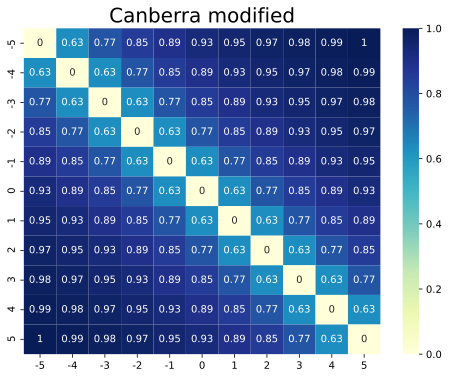

In [74]:
plt.subplots(figsize=(8, 6), dpi=600)
ax1 = sns.heatmap(distance_canx, cmap="YlGnBu", annot=True)
ax1.set_xticklabels(array)
ax1.set_yticklabels(array)
plt.title('Canberra modified',fontsize=20)
plt.show()

In [75]:
from numba import jit

@jit(nopython=True)
def modified_canberra(a,b):
    return np.sqrt(np.sum(np.array([np.abs(1.0 - x) / (1.0 + np.abs(x)) for x in (np.abs(a-b) + 1.0)])))

In [76]:
def feature_clustering(UMAP_neb,min_dist_UMAP, metric, data, visual):
    import umap.umap_ as umap
    np.random.seed(42)
    data_embedded = umap.UMAP(n_neighbors=UMAP_neb, min_dist=min_dist_UMAP, n_components=2, metric=metric, random_state=42).fit_transform(data)
    data_embedded[:,0]=(data_embedded[:,0]- np.mean(data_embedded[:,0]))/np.std(data_embedded[:,0])
    data_embedded[:,1]=(data_embedded[:,1]- np.mean(data_embedded[:,1]))/np.std(data_embedded[:,1])
    result = pd.DataFrame(data = data_embedded , 
        columns = ['UMAP_0', 'UMAP_1'])
    if visual==1:
        sns.lmplot( x="UMAP_0", y="UMAP_1",data=result,fit_reg=False,legend=False,scatter_kws={"s": 20},palette=customPalette_set1) # specify the point size
        #plt.savefig('clusters_umap_all.png', dpi=700, bbox_inches='tight')
        plt.show()
    else:
        pass
    return result



def FDC(data,cont_list,nom_list,ord_list,cont_metric, ord_metric, nom_metric, drop_nominal, visual):
    np.random.seed(42)
    colors_set1 = ["lightcoral", "lightseagreen", "mediumorchid", "orange", "burlywood", "cornflowerblue", "plum", "yellowgreen"]
    customPalette_set1 = sns.set_palette(sns.color_palette(colors_set1))
    cont_df=data[cont_list]
    nom_df=data[nom_list]
    ord_df=data[ord_list]
    cont_emb=feature_clustering(30,0.1, cont_metric, cont_df, 0) #Reducing continueous features into 2dim
    ord_emb=feature_clustering(30,0.1, ord_metric, ord_df, 0) #Reducing ordinal features into 2dim
    nom_emb=feature_clustering(30,0.1, nom_metric, nom_df, 0) #Reducing nominal features into 2dim
    if drop_nominal==1:
        result_concat=pd.concat([ord_emb, cont_emb, nom_emb.drop(['UMAP_1'],axis=1)],axis=1) #concatinating all reduced dimensions to get 5D embeddings(1D from nominal)
    else:
        result_concat=pd.concat([ord_emb, cont_emb, nom_emb],axis=1)
    data_embedded = umap.UMAP(n_neighbors=30, min_dist=0.001, n_components=2, metric='euclidean', random_state=42).fit_transform(result_concat) #reducing 5D embeddings to 2D using UMAP
    result_reduced = pd.DataFrame(data = data_embedded , 
        columns = ['FDC_1', 'FDC_2'])
    
    if visual==1:
        sns.lmplot( x="FDC_1", y="FDC_2",data=result_reduced,fit_reg=False,legend=False,scatter_kws={"s": 20},palette=customPalette_set1) # specify the point size
        plt.show()
        #plt.savefig('clusters_umap_all.png', dpi=700, bbox_inches='tight')
    else:
        pass
    return result_concat, result_reduced #returns both 5D and 2D embeddings

In [77]:
entire_data_FDC_emb_five,entire_data_FDC_emb_two=FDC(df_diabetes,cont_features,nom_features,ord_features,'euclidean',modified_canberra,'hamming',1,0)

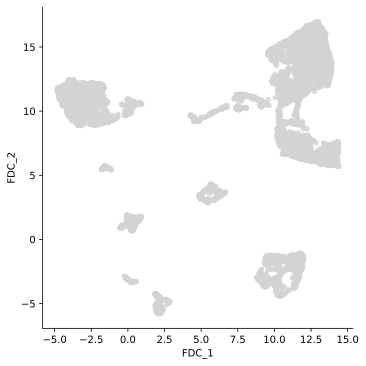

In [78]:
colors_set = ['lightgray','lightcoral','cornflowerblue','orange','mediumorchid', 'lightseagreen','olive', 'chocolate','steelblue',"paleturquoise",  "lightgreen",  'burlywood','lightsteelblue']
customPalette_set = sns.set_palette(sns.color_palette(colors_set))

sns.lmplot( x="FDC_1", y="FDC_2",
  data=entire_data_FDC_emb_two, 
  fit_reg=False, 
  legend=True,
  #hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20}, palette=customPalette_set) # specify the point size
plt.show()

In [79]:
results_DBSCAN_FDC = DBSCAN(eps=1, min_samples=15).fit_predict(entire_data_FDC_emb_two)
(values_dbscan,counts_dbscan) = np.unique(results_DBSCAN_FDC,return_counts=True)

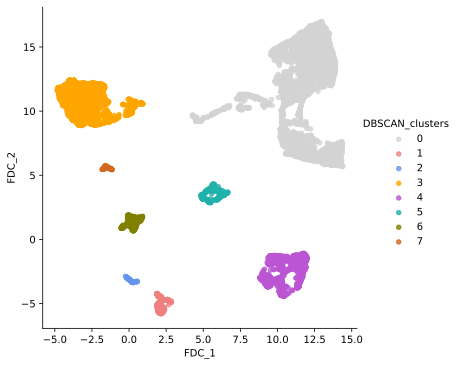

In [80]:
result=entire_data_FDC_emb_two
result['DBSCAN_clusters']=results_DBSCAN_FDC

sns.lmplot( x="FDC_1", y="FDC_2",
  data=result, 
  fit_reg=False, 
  legend=True,
  hue='DBSCAN_clusters', # color by cluster
  scatter_kws={"s": 20}, palette=customPalette_set) # specify the point size
plt.show()

## <span style="color:teal">More on interpretation</span>

In [81]:
def list_of_cluster_dfs(df, cluster_labels):
    if -1 in np.unique(np.array(cluster_labels)):
        clusters=np.unique(np.array(cluster_labels))[1:]
    else:
        clusters=np.unique(np.array(cluster_labels))

    df_clusters=[]
    for cluster in clusters:
        cluster_df=df.iloc[np.where(np.array(cluster_labels)==clusters[cluster])]
        df_clusters.append(cluster_df)
    return df_clusters

In [82]:
cluster_df_list=list_of_cluster_dfs(df_diabetes, results_DBSCAN_FDC)

We can find out which features exhibit significantly different distributions in different clusters

In [83]:
def significant_features(df,cluster_df_list,threshold=0.0001):
    from scipy.stats import f_oneway
    significant_features=[]
    for feature in df.columns:
        feature_distribution_cluster_wise=[]
        for cluster in range(len(cluster_df_list)):
            feature_distribution_cluster_wise.append(np.array(cluster_df_list[cluster][feature]))
        signifance_result=f_oneway(*feature_distribution_cluster_wise)
        if signifance_result[1]<threshold:
            significant_features.append(feature)
    return(np.array(significant_features))

In [84]:
sig_feats=significant_features(df_diabetes,cluster_df_list)

In [85]:
sig_feats

array(['Current.age', 'Sex', 'Currently.has.cancer',
       'Currently.taking.a.prescribed.medicine.to.lower.BP', 'BMI',
       'Hemoglobin.level..g.dl...1.decimal.', 'Hb_adjust_alt_smok',
       'Hb_status', 'Frequency.takes.milk.or.curd',
       'Frequency.eats.pulses.or.beans',
       'Frequency.eats.dark.green.leafy.vegetable',
       'Frequency.eats.fruits', 'Frequency.eats.eggs',
       'Frequency.eats.fish', 'Frequency.eats.chicken.or.meat',
       'Frequency.eats.fried.food', 'Frequency.takes.aerated.drinks',
       'Drinks.alcohol', 'Type.of.alcohol.usually.consumed..Tadi.madi',
       'Type.of.alcohol.usually.consumed..country.liquor',
       'Type.of.alcohol.usually.consumed..beer',
       'Type.of.alcohol.usually.consumed..wine',
       'Type.of.alcohol.usually.consumed..hard.liquor', 'Smoking_stat',
       'Frequency.household.members.smoke.inside.the.house',
       'Type.of.place.of.residence', 'Wealth.index',
       'Highest.educational.level', 'Household.head.s.religion

In [86]:
def visual_continuous_over_clusters(cluster_df_list, feature):
    
    if feature not in cont_features:
        raise Exception('Function not available for categorical features')
        
    means=[]
    sds=[]
    cluster_labels=[]
    
    cluster_counter=0
    for cluster in range(len(cluster_df_list)):
        print('Cluster '+ str(cluster_counter)+ ' summary statistics')
        print('\n')
        cm=cluster_df_list[cluster][feature].mean()
        cs=cluster_df_list[cluster][feature].std()
        print('feature mean:', cm)
        print('feature standard deviation:', cs)
        print('\n')
        means.append(cm)
        sds.append(cs)
        cluster_labels.append('C'+str(cluster_counter))
        cluster_counter=cluster_counter+1
    
    
    means=np.array(means)
    sds=np.array(sds)
    cluster_labels=np.array(cluster_labels)
    
    print('\n')  
    
    fig, ax7 = plt.subplots()
    ax7.bar(cluster_labels,means,yerr=sds)
    ax7.tick_params(axis='both', which='major', labelsize=10)
    plt.xlabel(feature, fontsize=15) 
    plt.show()
    
    return means,sds

In [87]:
def visual_categorical_over_clusters(cluster_df_list, feature, rev_dict=None):
    
    if feature in cont_features:
        raise Exception('Function not available for continuous features')
        
    cluster_bar=[]     
    
    for cluster in range(len(cluster_df_list)):
        if rev_dict==None:
            y=np.array(cluster_df_list[cluster][feature].value_counts().sort_index())
            x=np.array(cluster_df_list[cluster][feature].value_counts().sort_index().index)
            cluster_bar.append([x,y])
        else:
            y=np.array(cluster_df_list[cluster].replace({feature:r})[feature].value_counts())
            x=np.array(cluster_df_list[cluster].replace({feature:r})[feature].value_counts().index)
            cluster_bar.append([x,y])
        
    rows=3
    cols=int(np.ceil(len(cluster_df_list)/rows))
    figx, ax = plt.subplots(rows, cols)
    figx.set_size_inches(20, 15)
    c=0
    for i in range(rows):
        for j in range(cols):
            ax[i,j].bar(cluster_bar[c][0],cluster_bar[c][1])
            ax[i,j].tick_params(axis='x', which='major', labelsize=8, rotation= 90)
            ax[i,j].set_title('Cluster: '+str(c))
            if c==len(cluster_df_list)-1:
                break
            else:
                c=c+1
                        
    return cluster_bar

Cluster 0 summary statistics


feature mean: 25.24456387256426
feature standard deviation: 5.041663130193055


Cluster 1 summary statistics


feature mean: 26.46257217847768
feature standard deviation: 4.798882841285233


Cluster 2 summary statistics


feature mean: 27.365974842767283
feature standard deviation: 5.337803691831282


Cluster 3 summary statistics


feature mean: 25.98865164096478
feature standard deviation: 5.447304070683691


Cluster 4 summary statistics


feature mean: 24.4704052443385
feature standard deviation: 9.220426531836829


Cluster 5 summary statistics


feature mean: 23.892390852390857
feature standard deviation: 4.6661181114765515


Cluster 6 summary statistics


feature mean: 24.526961206896537
feature standard deviation: 10.021070007415586


Cluster 7 summary statistics


feature mean: 24.287024793388426
feature standard deviation: 5.0452990734986995






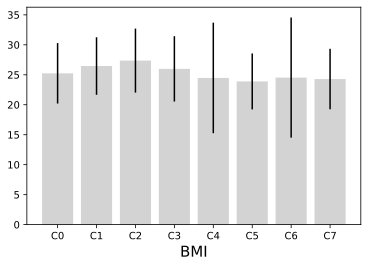

(array([25.24456387, 26.46257218, 27.36597484, 25.98865164, 24.47040524,
        23.89239085, 24.52696121, 24.28702479]),
 array([ 5.04166313,  4.79888284,  5.33780369,  5.44730407,  9.22042653,
         4.66611811, 10.02107001,  5.04529907]))

In [88]:
visual_continuous_over_clusters(cluster_df_list, 'BMI')

[[array([0, 1, 2, 3], dtype=int64),
  array([ 274, 2535, 3178,  479], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64), array([ 10, 114, 228,  29], dtype=int64)],
 [array([0, 1, 2], dtype=int64), array([136,  14,   9], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64),
  array([2237,  191,   88,   13], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64), array([ 57, 674, 865,  82], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64), array([ 19, 167, 266,  29], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64), array([402,  38,  20,   4], dtype=int64)],
 [array([0, 1, 2, 3], dtype=int64), array([104,   7,   9,   1], dtype=int64)]]

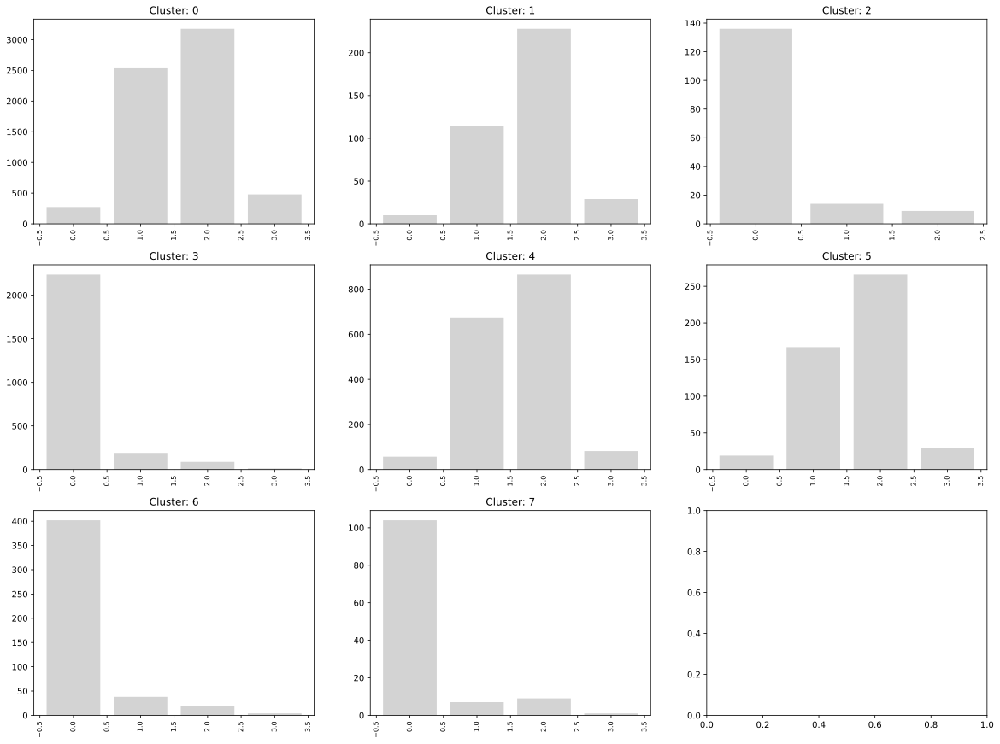

In [89]:
visual_categorical_over_clusters(cluster_df_list, 'Frequency.eats.eggs')

## <span style="color:teal">Take-home messages</span>

<font size="3">
<br>

- The idea of machine learning is to represent real-world data, be it tabular, images, texts in terms of numbers
- These representations have to be designed in such a way that the set of numbers representing similar objects are closer to each other and vice-versa. Machine Learning algorithms are designed to achieve this basic goal
- Tabular data used for clinical decision making using Machine Learning has diverse feature types
- It is crucial to analyze the patterns present in the data to achieve explainable decision-making
- Pre-processing is necessary to select relevant features, impue missing values and convert the raw data into a refined numeric table that is further used for Machine Learning
- Clustering algorithms help us group similar data points from high dimensional data
- Since we cannot vizualize high dimensional data, Dimension reduction algorithms are used to create lower dimensional embeddings of the data that again helps us in vizualization
- A basic strategy is to observe the data in the lower dimension that captures the maximum information (high variance). This is achieved by PCA
- There are non-linear strategies of dimension reduction that rely on non-linear measures of similarity, such as UMAP.
- The Feature-type Distributed Clustering workflow can further improve clustering on tabular patient data, by taking into account separate similarity measures for different variable types    
  